# Determine CD16+ T cells

Here we examine whether we can identify CD16+ T cells in the CITE-seq data. For this purpose, we have inferred the foreground protein abundance with TotalVI and computed a joint embedding of both RNA and protein space. We use the joint latent embedding to determine reliable thresholds for the definition of CD16+ T cells.  

In [2]:
import scanpy as sc
import anndata as ann
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
import mudata as md
import muon as mu
#import scvi

2023-03-21 14:03:56.414283: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-21 14:03:59.363443: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-03-21 14:03:59.363467: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2023-03-21 14:04:15.210595: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-

In [3]:
sc.logging.print_header()

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.2.1 statsmodels==0.13.5 python-igraph==0.10.4 louvain==0.8.0 pynndescent==0.5.8


## Set paths

In [4]:
file_path = '/home/marenbuettner/development/citeseq_integration/' 
#this is my file path please adapt it to your directory

The data directory contains all processed data and `anndata` files. 

In [5]:
data_dir = file_path + 'data/' 

Raw data path is the directory of the primary data, which are used in the project. 

In [6]:
data_raw_dir = '/home/marenbuettner/public_data/covid_citeseq_stephenson2021/'

The default figure path is a POSIX path calles 'figures'. If you don't change the default figure directory, scanpy creates a subdirectory where this notebook is located.  

In [7]:
sc.settings.figdir = file_path + 'figures/'

**Comment:** When you repeat certain analyses, it might be helpful to set a date variable and add it to every figure and table (see `datetime` Python package).

In [8]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

## Read data

Due to some issues with the joint `var_names` in the `MuData` object, we have to load the modalities separately:  

In [9]:
adata = md.read(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu/rna')

In [10]:
pdata = md.read(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu/protein')

In [21]:
adata_subset = md.read_h5ad(f'{data_dir}haniffa21_totalVI_Covid_Healthy.h5mu', mod='rna_subset')

In [11]:
adata

AnnData object with n_obs × n_vars = 624325 × 24737
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
    var: 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'raw'

In [12]:
pdata

AnnData object with n_obs × n_vars = 624325 × 192
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch'
    var: 'feature_types'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'denoised_protein', 'protein_foreground_prob', 'raw'

In [22]:
adata_subset

AnnData object with n_obs × n_vars = 624325 × 3000
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
    var: 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
    layers: 'denoised_rna', 'raw'
    obsp: 'connectivities', 'distances'

Reconstruct the MuData object.

In [25]:
mdata = md.MuData({"rna": adata, "protein": pdata, "rna_subset": adata_subset})
mdata

/home/marenbuettner/miniconda3/envs/muon/lib/python3.8/site-packages/mudata/_core/mudata.py:458: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


MuData object with n_obs × n_vars = 624325 × 27929
  3 modalities
    rna:	624325 x 24737
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'raw'
    protein:	624325 x 192
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch'
      var:	'feature_types'
      uns:	'hvg', 'leiden', 'neighbors', 'pca', 'umap'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'denoised_protein', 'protein_foreground_prob', 'raw'
    rna_subset:	624325 x 3000
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
      layers:	'denoised_rna', 'raw'
      obsp:	'connectivities', 'distances'

## Visualize data

/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


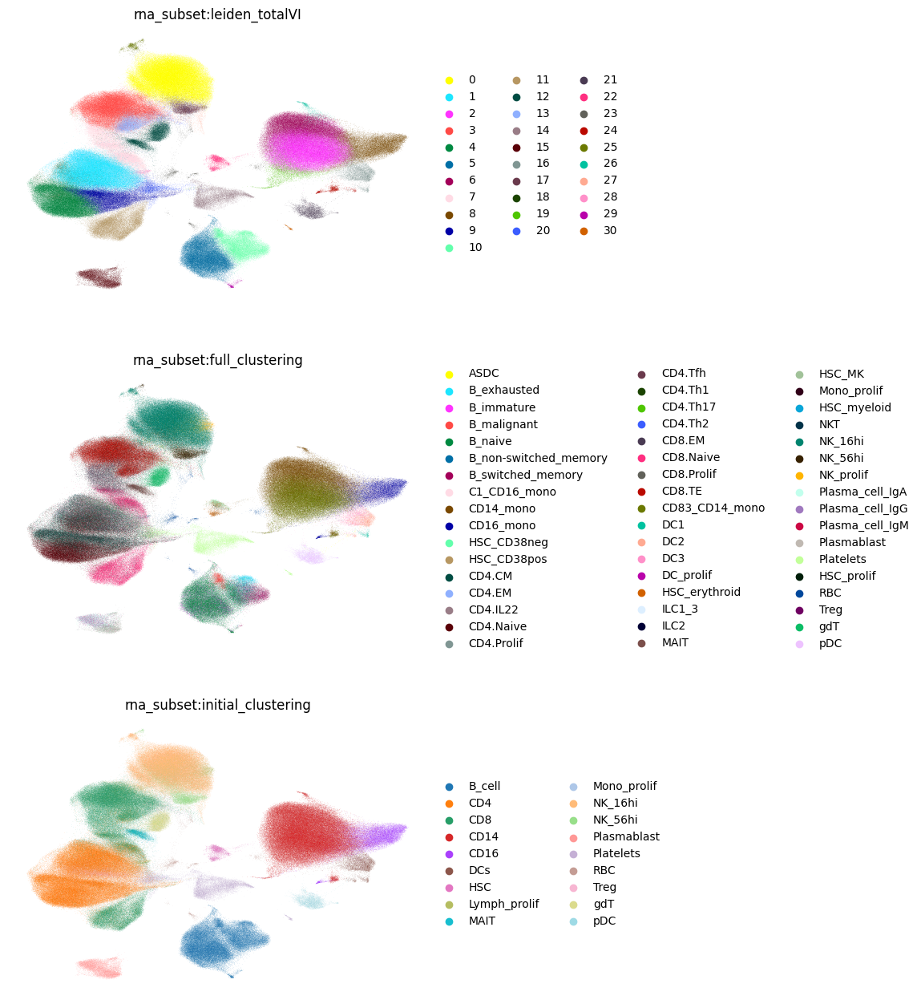

In [182]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=["rna_subset:leiden_totalVI", "rna_subset:full_clustering", 'rna_subset:initial_clustering'],
    frameon=False,
    ncols=1,
)

/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


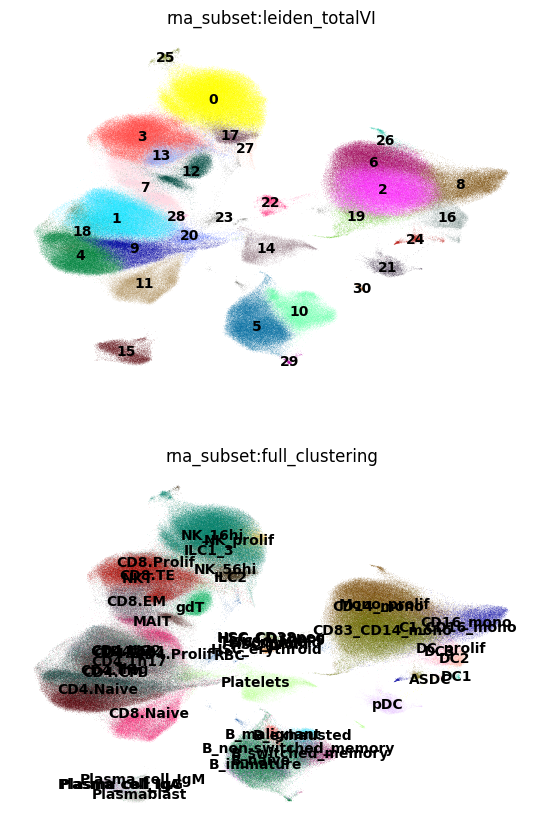

In [41]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=["rna_subset:leiden_totalVI", "rna_subset:full_clustering"],
    frameon=False,
    ncols=1,
    legend_loc='on data'
)

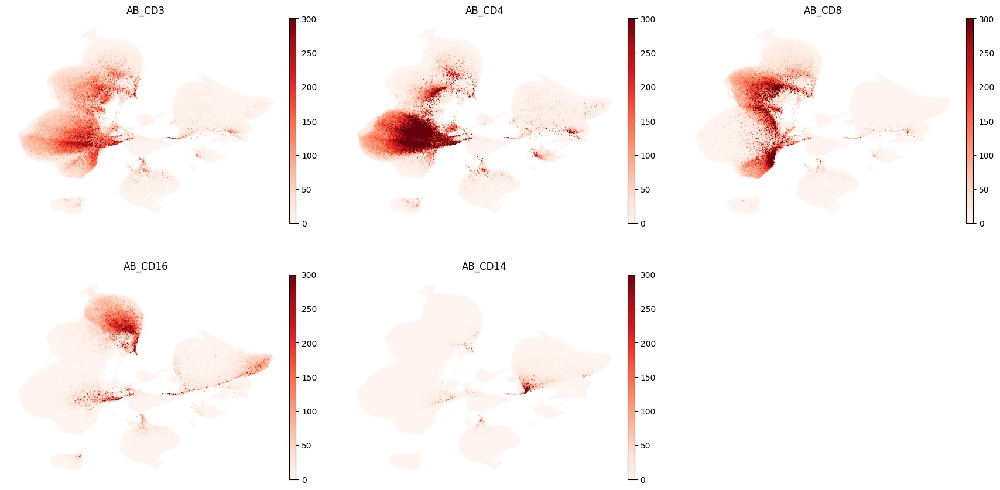

In [36]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=['AB_CD3', 'AB_CD4', 'AB_CD8', 'AB_CD16', 'AB_CD14'],
    frameon=False,
    ncols=3,
    vmax=300,
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

In [165]:
pdata.obs['leiden_totalVI']=mdata.mod['rna_subset'].obs['leiden_totalVI'].copy()

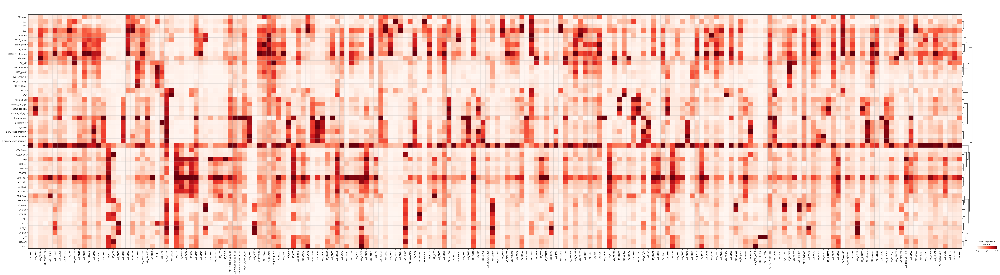

In [178]:
sc.pl.matrixplot(pdata, groupby='full_clustering', dendrogram=True,
                 var_names=pdata.var_names, standard_scale='var', log=True,
                 cmap='Reds', layer='denoised_protein')

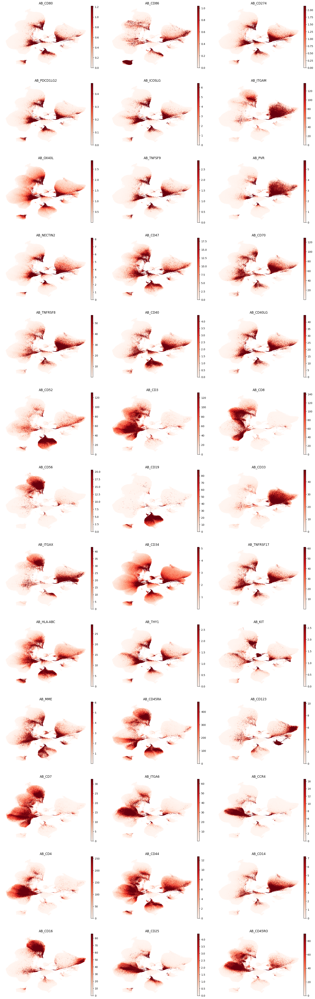

In [79]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

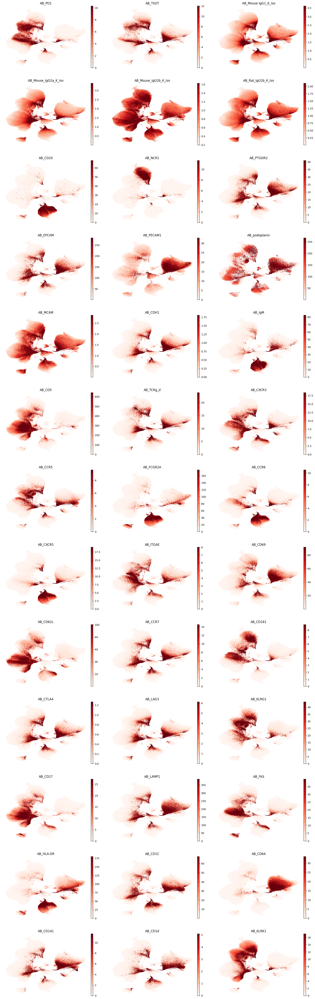

In [80]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[39:][:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

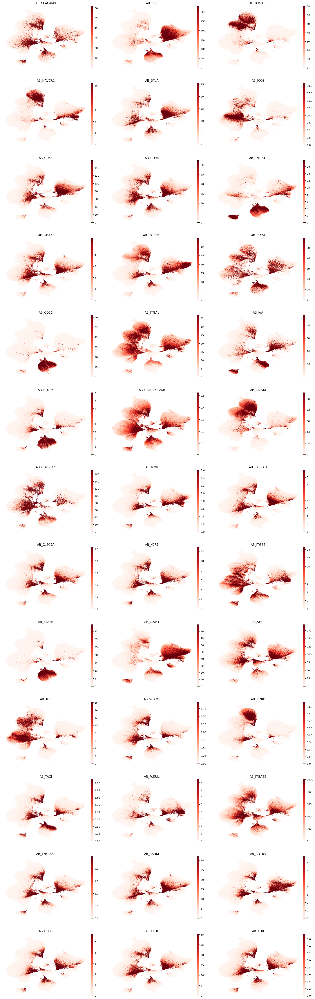

In [81]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    color=pdata.var_names[78:][:39],
    frameon=False,
    ncols=3,
    vmax="p99",
    wspace=0.1,
    cmap='Reds',
    size=5,
    layer="denoised_protein",
)

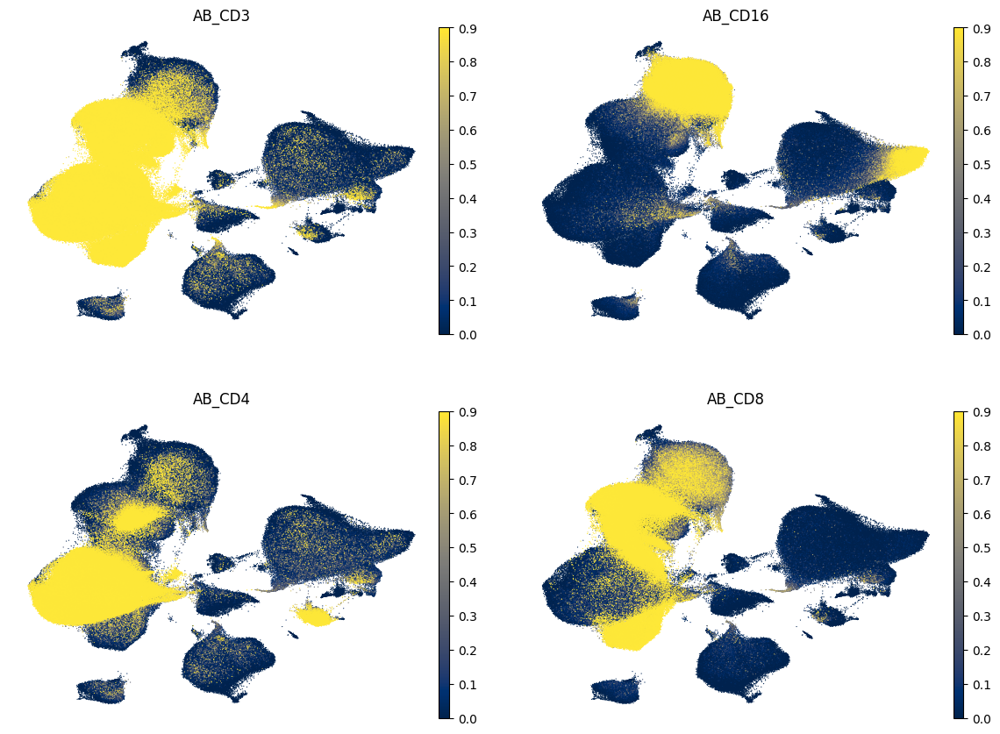

In [180]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    layer="protein_foreground_prob",
    color=['AB_CD3', 'AB_CD16', 'AB_CD4', 'AB_CD8'],
    frameon=False,
    ncols=2,
    vmax=0.9,
    size=3,
    wspace=0.1,
    color_map="cividis",
)

In [156]:
pdata

AnnData object with n_obs × n_vars = 624325 × 192
    obs: 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'CD16+ T cell', 'CD16+ T cells'
    var: 'feature_types'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'umap', 'full_clustering_colors', 'CD16+ T cells_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    layers: 'denoised_protein', 'protein_foreground_prob', 'raw'

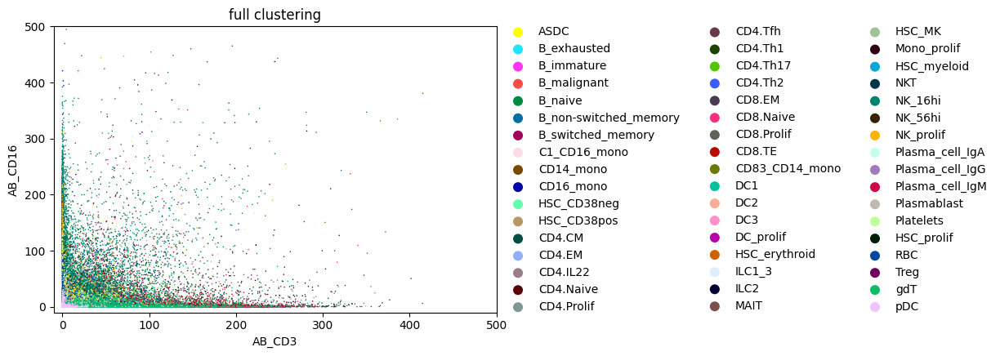

In [45]:
ax = sc.pl.scatter(pdata, x='AB_CD3', y='AB_CD16', color='full_clustering', show=False, size=5, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

## Determine threshold for CD16+ cells

We are looking for CD16+ T cells (both CD4 and CD8 compartment). 

In [183]:
cd4_comp = []
cd8_comp = []

for group in adata.obs['initial_clustering'].cat.categories:
    
    if group.startswith('CD4'):
        cd4_comp.append(group)
    elif group.startswith('CD8'):
        cd8_comp.append(group)

In [189]:
pdata_t_cell = pdata[pdata.obs['initial_clustering'].isin(cd4_comp + cd8_comp)].copy()

In [199]:
prob_cd16 = pdata_t_cell.layers['protein_foreground_prob'][:, pdata.var_names =='AB_CD16'].squeeze()

In [200]:
pdata_t_cell.obs['prob_cd16'] = prob_cd16

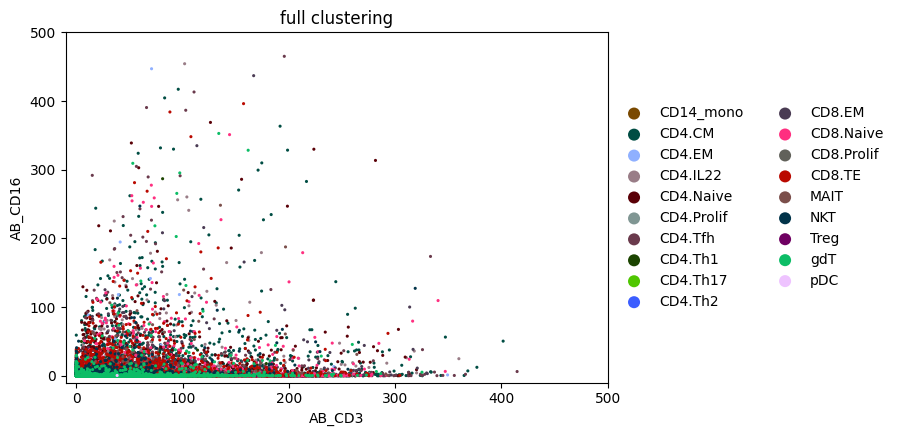

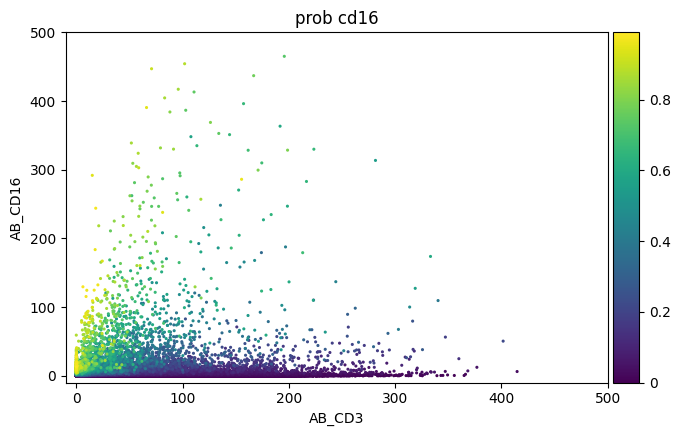

In [192]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='full_clustering', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='prob_cd16', show=False, size=20, layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

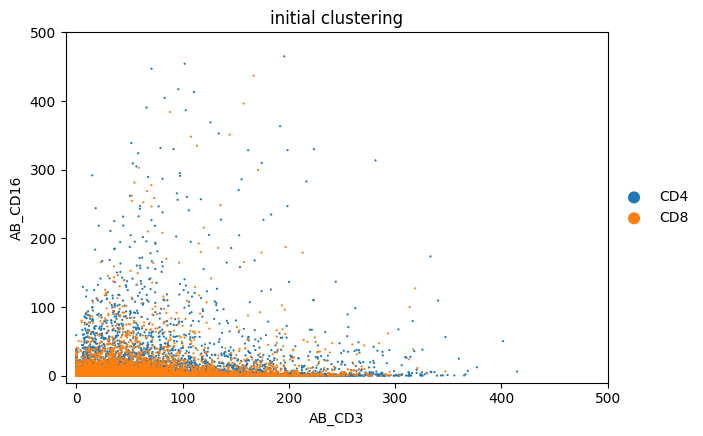

In [219]:
ax = sc.pl.scatter(pdata_t_cell, x='AB_CD3', y='AB_CD16', 
                   color='initial_clustering', 
                   #alpha=0.8,
                   show=False, 
                   size=10,
                   layers='denoised_protein')
ax.set_xlim([-10, 500])
ax.set_ylim([-10, 500])
plt.show()

We use a threshold of P(CD16, foreground) > 0.5 to define CD16 positive cells.

In [194]:
pdata_t_cell[pdata_t_cell.obs['prob_cd16']>0.5].obs[['initial_clustering','Status']].value_counts()

initial_clustering  Status 
CD4                 Covid      653
CD8                 Covid      504
                    Healthy     67
CD4                 Healthy     55
dtype: int64

Visualise CD16+ T cells on joint UMAP.

In [135]:
protein = mdata.mod['protein']

In [195]:
prob_cd16 = pdata.layers['protein_foreground_prob'][:, pdata.var_names =='AB_CD16'].squeeze()

bool_mask = np.logical_and(prob_cd16>0.5,  pdata.obs['initial_clustering'].isin(cd4_comp))
bool_mask2 = np.logical_and(prob_cd16>0.5,  pdata.obs['initial_clustering'].isin(cd8_comp))

protein.obs['CD16+ T cells'] = 'other'
protein.obs['CD16+ T cells'][bool_mask] = 'CD16+ CD4+ T cell'
protein.obs['CD16+ T cells'][bool_mask2] = 'CD16+ CD8+ T cell'
protein.obs['CD16+ T cells'] = mdata.mod['protein'].obs['CD16+ T cell'].astype('category')

/tmp/ipykernel_987929/2572173374.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  protein.obs['CD16+ T cells'][bool_mask] = 'CD16+ CD4+ T cell'
/tmp/ipykernel_987929/2572173374.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  protein.obs['CD16+ T cells'][bool_mask2] = 'CD16+ CD8+ T cell'


In [196]:
protein.obs['CD16+ T cells'].value_counts()

other                622434
CD16+ CD8+ T cell      1144
CD16+ CD4+ T cell       747
Name: CD16+ T cells, dtype: int64

In [197]:
pd.crosstab(protein.obs['CD16+ T cells'], mdata.mod['rna_subset'].obs['leiden_totalVI']).T

CD16+ T cells,CD16+ CD4+ T cell,CD16+ CD8+ T cell,other
leiden_totalVI,,,
0,180,596,93783
1,54,0,69672
2,0,0,69297
3,37,367,54657
4,12,0,47617
5,0,0,40784
6,0,0,40475
7,5,9,24576
8,0,0,23959


In [144]:
mdata

MuData object with n_obs × n_vars = 624325 × 27929
  3 modalities
    rna:	624325 x 24737
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'raw'
    protein:	624325 x 192
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'CD16+ T cell', 'CD16+ T cells'
      var:	'feature_types'
      uns:	'hvg', 'leiden', 'neighbors', 'pca', 'umap', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_umap'
      layers:	'denoised_protein', 'protein_foreground_prob', 'raw'
    rna_subset:	624325 x 3000
      obs:	'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'full_clustering', 'initial_clustering', 'Resample', 'Collection_Day', 'Sex', 'Age_interval', 'Swab_result', 'Status', 'Smoker', 'Status_on_day_collection', 'Status_on_day_collection_summary', 'Days_from_onset', 'Site', 'time_after_LPS', 'Worst_Clinical_Status', 'Outcome', 'patient_id', '_scvi_batch', 'leiden_totalVI'
      var:	'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
      uns:	'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'full_clustering_colors'
      obsm:	'X_pca', 'X_pca_harmony', 'X_totalVI', 'X_umap'
      layers:	'denoised_rna', 'raw'
      obsp:	'connectivities', 'distances'

In [147]:
protein.uns['CD16+ T cells_colors'] = ['#fd349a', '#92fab1', '#bbbbbb']

In [148]:
mdata.update()

/home/marenbuettner/miniconda3/envs/muon/lib/python3.8/site-packages/mudata/_core/mudata.py:458: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


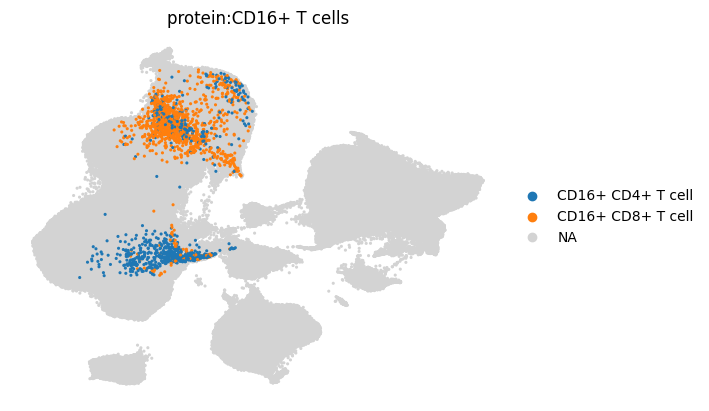

In [198]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    #layer="protein",
    color='protein:CD16+ T cells',
    groups=['CD16+ CD8+ T cell', 'CD16+ CD4+ T cell'],
    frameon=False,
    ncols=3,
    size=20,
    wspace=0.1)

/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/marenbuettner/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


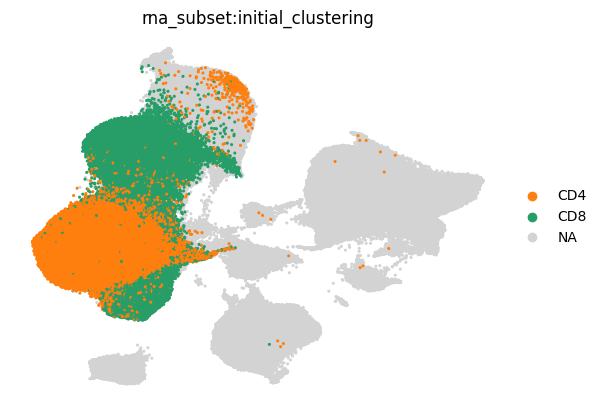

In [220]:
mu.pl.embedding(
    mdata,
    basis="rna_subset:X_umap",
    #layer="protein",
    color='rna_subset:initial_clustering',
    groups=['CD8', 'CD4'],
    frameon=False,
    ncols=3,
    size=20,
    wspace=0.1)

In [221]:
mdata.update()

/home/marenbuettner/miniconda3/envs/muon/lib/python3.8/site-packages/mudata/_core/mudata.py:458: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


Write data to file.

In [222]:
mdata.write(f'{data_dir}haniffa21_totalVI_Covid_Healthy_annotated.h5mu')

/home/marenbuettner/miniconda3/envs/muon/lib/python3.8/site-packages/mudata/_core/mudata.py:458: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(
